# Exploratory Data Analysis (EDA)

In [213]:
!pip install category_encoders

In [214]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import operator
import plotly.graph_objects as go

In [215]:
df = pd.read_csv("../data/clean/clean.csv", sep=',')

In [216]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [217]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')

In [218]:
df.shape

(41176, 21)

In [219]:
df.age.describe()

count    41176.00000
mean        40.02380
std         10.42068
min         17.00000
25%         32.00000
50%         38.00000
75%         47.00000
max         98.00000
Name: age, dtype: float64

- The average customer is 40 years old.

In [220]:
df.age.median()

38.0

In [221]:
df.age.value_counts()

31    1947
32    1845
33    1833
36    1779
35    1758
      ... 
89       2
91       2
87       1
94       1
95       1
Name: age, Length: 78, dtype: int64

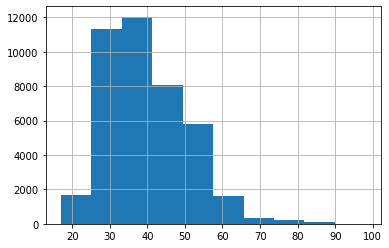

In [222]:
df.age.hist()

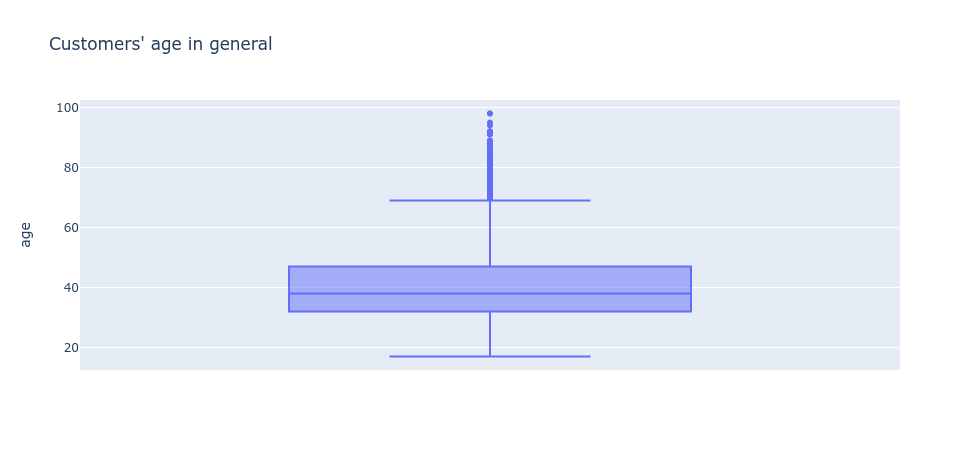

In [548]:
px.box(df, y="age", title="Customers' age in general")

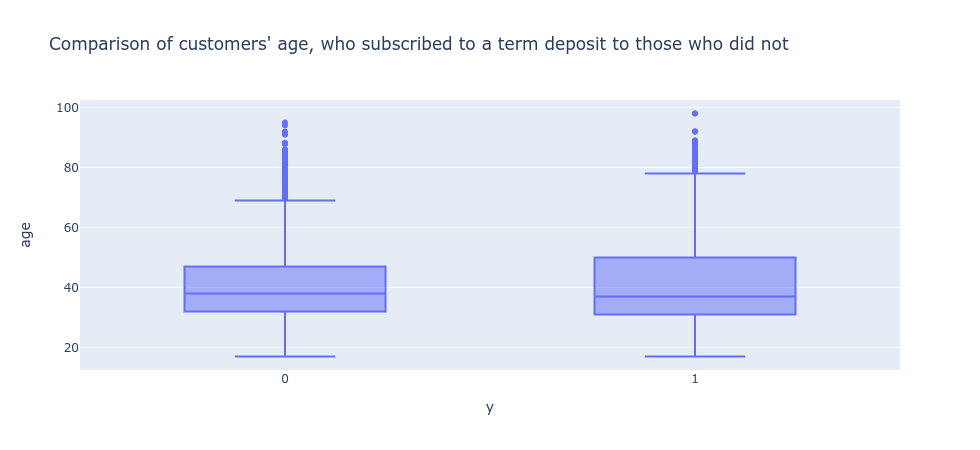

In [547]:
px.box(df, y="age", x="y", title="Comparison of customers' age, who subscribed to a term deposit to those who did not")

In [223]:
df.job.value_counts()

admin.           10419
blue-collar       9253
technician        6739
services          3967
management        2924
retired           1718
entrepreneur      1456
self-employed     1421
housemaid         1060
unemployed        1014
student            875
unknown            330
Name: job, dtype: int64

- Most customers work in the admin. sector.

# Distribution of customers in terms of their job

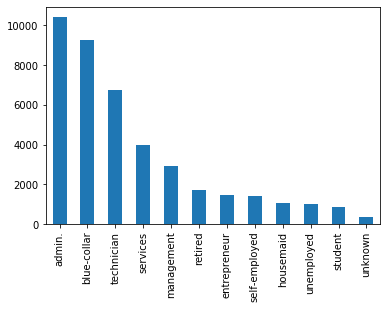

In [224]:
df.job.value_counts().plot(kind="bar")

### Different representation

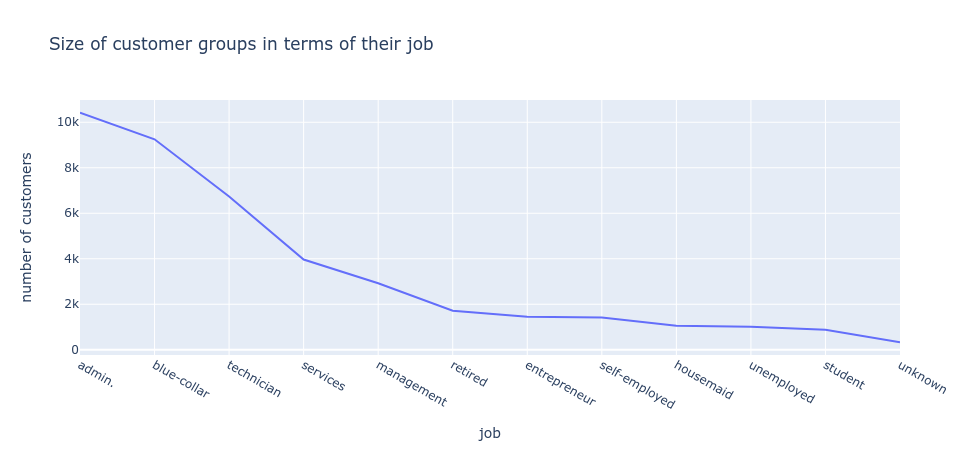

In [554]:
data_job = df.job.value_counts()
px.line(data_job, x=data_job.index, y=data_job.values, labels={"x":"job", "y": "number of customers"}, title="Size of customer groups in terms of their job")

In [225]:
df.marital.value_counts()

married     24921
single      11564
divorced     4611
unknown        80
Name: marital, dtype: int64

- Most customers are married.

In [226]:
df.education.value_counts()

university.degree      12164
high.school             9512
basic.9y                6045
professional.course     5240
basic.4y                4176
basic.6y                2291
unknown                 1730
illiterate                18
Name: education, dtype: int64

- Most customres have a university degree.

In [227]:
df.default.value_counts()

no         32577
unknown     8596
yes            3
Name: default, dtype: int64

- Most values of "default" are "no".
- Only three customers answered with "yes".

In [228]:
df.housing.value_counts()

yes        21571
no         18615
unknown      990
Name: housing, dtype: int64

- Most customers have a housing loan.

In [229]:
df.loan.value_counts()

no         33938
yes         6248
unknown      990
Name: loan, dtype: int64

- Most customers have no personal loan.

In [230]:
df.contact.value_counts()

cellular     26135
telephone    15041
Name: contact, dtype: int64

- Most customers were contacted via the cellular phone.

In [231]:
df.month.value_counts()

may    13767
jul     7169
aug     6176
jun     5318
nov     4100
apr     2631
oct      717
sep      570
mar      546
dec      182
Name: month, dtype: int64

- Most customers were contacted in May.

In [232]:
df.day_of_week.value_counts()

thu    8618
mon    8512
wed    8134
tue    8086
fri    7826
Name: day_of_week, dtype: int64

- With a minor difference, most customers were contaced on Thurdsay.

In [233]:
df.duration.describe()

count    41176.000000
mean       258.315815
std        259.305321
min          0.000000
25%        102.000000
50%        180.000000
75%        319.000000
max       4918.000000
Name: duration, dtype: float64

- The average phone call lasted 258.3 seconds.

In [234]:
df.duration.median()

180.0

In [235]:
df.duration.value_counts()

85      170
90      170
136     168
73      167
124     163
       ... 
1108      1
980       1
4918      1
2453      1
2015      1
Name: duration, Length: 1544, dtype: int64

In [236]:
df.campaign.describe()

count    41176.000000
mean         2.567879
std          2.770318
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         56.000000
Name: campaign, dtype: float64

- The number of contacts performed during this campaign and for this client is on average 2.568.

In [237]:
df.campaign.median()

2.0

In [238]:
df.campaign.value_counts()

1     17634
2     10568
3      5340
4      2650
5      1599
6       979
7       629
8       400
9       283
10      225
11      177
12      125
13       92
14       69
17       58
15       51
16       51
18       33
20       30
19       26
21       24
22       17
23       16
24       15
27       11
29       10
25        8
26        8
28        8
30        7
31        7
35        5
33        4
32        4
34        3
40        2
42        2
43        2
37        1
39        1
41        1
56        1
Name: campaign, dtype: int64

In [239]:
df.pdays.describe()

count    41176.000000
mean       962.464810
std        186.937102
min          0.000000
25%        999.000000
50%        999.000000
75%        999.000000
max        999.000000
Name: pdays, dtype: float64

- The average number of days that passed by after the client was last contacted from a previous campaign is 962.46 days.

In [240]:
df.pdays.median()

999.0

In [241]:
df.pdays.value_counts()

999    39661
3        439
6        412
4        118
9         64
2         61
7         60
12        58
10        52
5         46
13        36
11        28
1         26
15        24
14        20
8         18
0         15
16        11
17         8
18         7
19         3
22         3
21         2
26         1
20         1
25         1
27         1
Name: pdays, dtype: int64

In [242]:
df.previous.describe()

count    41176.000000
mean         0.173013
std          0.494964
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          7.000000
Name: previous, dtype: float64

- On average, the customers have subscribed to 0.173 term deposits previously.

In [243]:
df.previous.median()

0.0

In [244]:
df.previous.value_counts()

0    35551
1     4561
2      754
3      216
4       70
5       18
6        5
7        1
Name: previous, dtype: int64

In [245]:
df.poutcome.value_counts()

nonexistent    35551
failure         4252
success         1373
Name: poutcome, dtype: int64

In [246]:
df['emp.var.rate'].describe()

count    41176.000000
mean         0.081922
std          1.570883
min         -3.400000
25%         -1.800000
50%          1.100000
75%          1.400000
max          1.400000
Name: emp.var.rate, dtype: float64

In [247]:
df['emp.var.rate'].median()

1.1

In [248]:
df['emp.var.rate'].value_counts()

 1.4    16228
-1.8     9182
 1.1     7762
-0.1     3682
-2.9     1662
-3.4     1070
-1.7      773
-1.1      635
-3.0      172
-0.2       10
Name: emp.var.rate, dtype: int64

In [249]:
df['cons.price.idx'].describe()

count    41176.000000
mean        93.575720
std          0.578839
min         92.201000
25%         93.075000
50%         93.749000
75%         93.994000
max         94.767000
Name: cons.price.idx, dtype: float64

In [250]:
df['cons.price.idx'].median()

93.749

In [251]:
df['cons.price.idx'].value_counts()

93.994    7762
93.918    6681
92.893    5793
93.444    5173
94.465    4374
93.200    3615
93.075    2457
92.201     770
92.963     715
92.431     446
92.649     357
94.215     311
94.199     303
92.843     282
92.379     267
93.369     264
94.027     233
94.055     229
93.876     212
94.601     204
92.469     177
93.749     174
92.713     172
94.767     128
93.798      67
92.756      10
Name: cons.price.idx, dtype: int64

In [252]:
df['cons.conf.idx'].describe()

count    41176.000000
mean       -40.502863
std          4.627860
min        -50.800000
25%        -42.700000
50%        -41.800000
75%        -36.400000
max        -26.900000
Name: cons.conf.idx, dtype: float64

In [253]:
df['cons.conf.idx'].median()

-41.8

In [254]:
df['cons.conf.idx'].value_counts()

-36.4    7762
-42.7    6681
-46.2    5793
-36.1    5173
-41.8    4374
-42.0    3615
-47.1    2457
-31.4     770
-40.8     715
-26.9     446
-30.1     357
-40.3     311
-37.5     303
-50.0     282
-29.8     267
-34.8     264
-38.3     233
-39.8     229
-40.0     212
-49.5     204
-33.6     177
-34.6     174
-33.0     172
-50.8     128
-40.4      67
-45.9      10
Name: cons.conf.idx, dtype: int64

In [255]:
df.euribor3m.describe()

count    41176.000000
mean         3.621293
std          1.734437
min          0.634000
25%          1.344000
50%          4.857000
75%          4.961000
max          5.045000
Name: euribor3m, dtype: float64

- The average euribor3m value was 3.62.

In [256]:
df.euribor3m.median()

4.857

In [257]:
df.euribor3m.value_counts()

4.857    2868
4.962    2611
4.963    2487
4.961    1902
4.856    1210
         ... 
3.053       1
0.956       1
1.045       1
0.996       1
0.933       1
Name: euribor3m, Length: 316, dtype: int64

In [258]:
df['nr.employed'].describe()

count    41176.000000
mean      5167.034870
std         72.251364
min       4963.600000
25%       5099.100000
50%       5191.000000
75%       5228.100000
max       5228.100000
Name: nr.employed, dtype: float64

In [259]:
df['nr.employed'].median()

5191.0

In [260]:
df['nr.employed'].value_counts()

5228.1    16228
5099.1     8532
5191.0     7762
5195.8     3682
5076.2     1662
5017.5     1070
4991.6      773
5008.7      650
4963.6      635
5023.5      172
5176.3       10
Name: nr.employed, dtype: int64

## Is the output variable balanced?

In [297]:
y_counts = df.y.value_counts()
y_counts

0    36537
1     4639
Name: y, dtype: int64

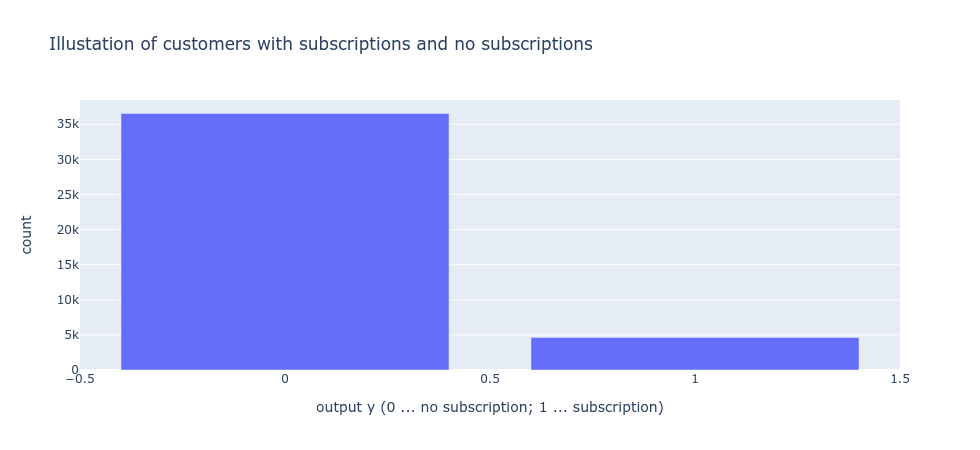

In [361]:
px.bar(x=y_counts.index, y=y_counts.values, labels={"x":"output y (0 ... no subscription; 1 ... subscription)", "y":"count"}, title="Illustation of customers with subscriptions and no subscriptions")

In [557]:
y_values = df.y.value_counts().values.tolist()
y_keys = df.y.value_counts().keys().tolist()

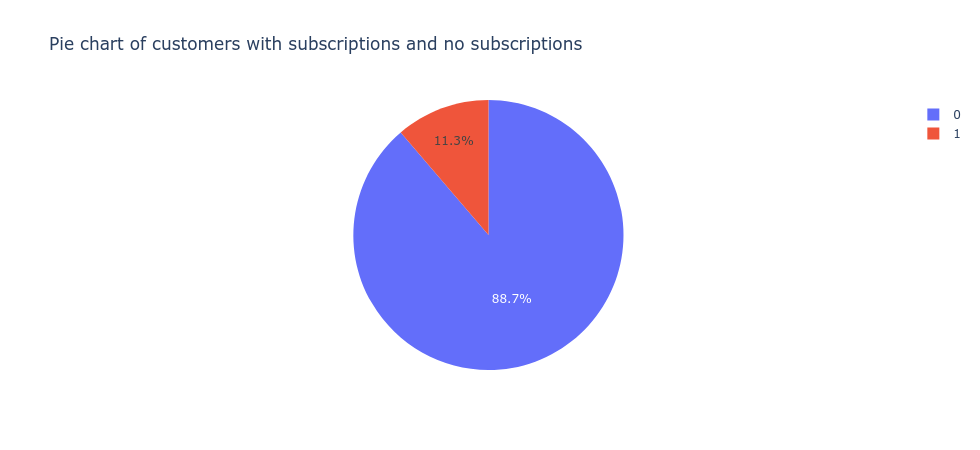

In [559]:
px.pie(values=y_values, names=y_keys, labels=y_keys, title='Pie chart of customers with subscriptions and no subscriptions')

- The output variable to predict is very imbalanced.
- Care needs to be taken, when predicting this output variable!

## Calculate the correlation matrix of the dataframe and find correlations to the output variable "y"!

**convert column "y" to binary value for the correlation matrix**

In [262]:
df.y = df.y.map({'no':0, 'yes':1})

**Calculate the correlation on the whole dataframe**

In [263]:
correlation_matrix = df.corr() # results in a correlation matrix
correlation_matrix

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
age,1.000000,-0.000808,0.004622,-0.034381,0.024379,-0.000242,0.001009,0.129075,0.010852,-0.017607,0.030381
duration,-0.000808,1.000000,-0.071765,-0.047556,0.020600,-0.027941,0.005303,-0.008126,-0.032861,-0.044672,0.405297
campaign,0.004622,-0.071765,1.000000,0.052606,-0.079182,0.150786,0.127826,-0.013657,0.135169,0.144129,-0.066361
pdays,-0.034381,-0.047556,0.052606,1.000000,-0.587508,0.271063,0.078920,-0.091374,0.296946,0.372659,-0.324948
previous,0.024379,0.020600,-0.079182,-0.587508,1.000000,-0.420587,-0.203197,-0.050929,-0.454571,-0.501411,0.230202
emp.var.rate,-0.000242,-0.027941,0.150786,0.271063,-0.420587,1.000000,0.775293,0.196257,0.972244,0.906949,-0.298289
cons.price.idx,0.001009,0.005303,0.127826,0.078920,-0.203197,0.775293,1.000000,0.059170,0.688180,0.521945,-0.136134
cons.conf.idx,0.129075,-0.008126,-0.013657,-0.091374,-0.050929,0.196257,0.059170,1.000000,0.277864,0.100679,0.054802
euribor3m,0.010852,-0.032861,0.135169,0.296946,-0.454571,0.972244,0.688180,0.277864,1.000000,0.945146,-0.307740
nr.employed,-0.017607,-0.044672,0.144129,0.372659,-0.501411,0.906949,0.521945,0.100679,0.945146,1.000000,-0.354669


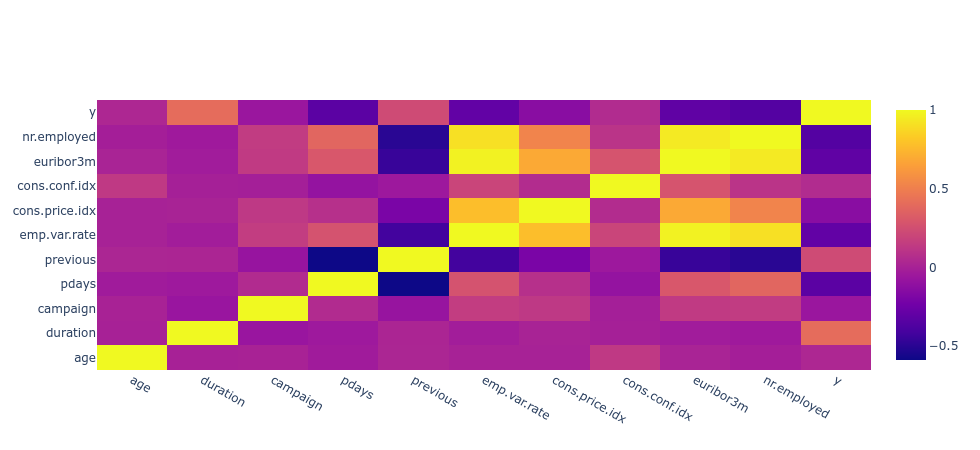

In [264]:
fig = go.Figure(data=go.Heatmap(x=correlation_matrix.columns, y=correlation_matrix.columns,z=correlation_matrix))
fig.show()

**_Observation:_**
**Higher correlations with "y" are:**
- duration: 0.405
- previous: 0.2302
- cons.conf.idx: 0.0548
- age: 0.0309

## How are the jobs distributed over the age?

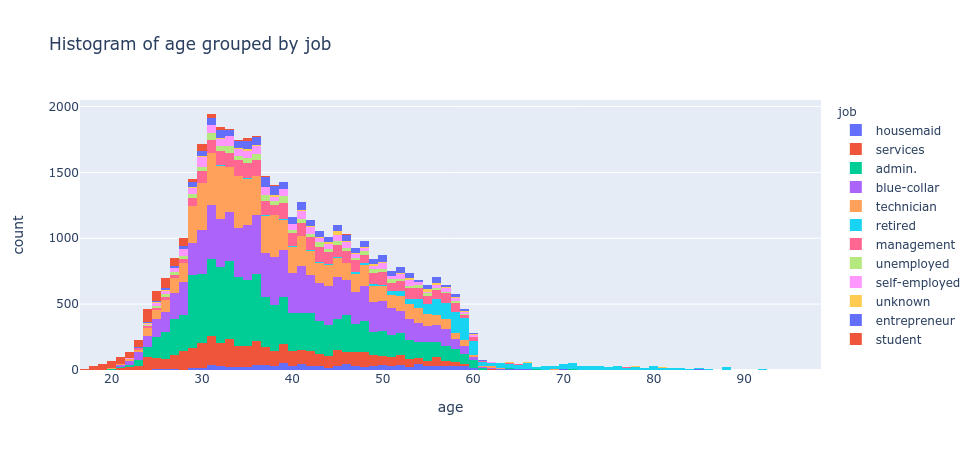

In [265]:
px.histogram(df, x="age", color="job", title="Histogram of age grouped by job")

- The joungest customers are 17.

- In the age group from 17 to 19, all recorded customers are students.

- In the joung age group from 17 to 22, the major customer group are students.

- Most term deposits are subscribed in the age group 29 to 39.

    - In this age group admin. jobs dominate.


- Starting with age 58, most customers are are retired.

- The oldest customers are 98.

In [284]:
df.age.describe()

count    41176.00000
mean        40.02380
std         10.42068
min         17.00000
25%         32.00000
50%         38.00000
75%         47.00000
max         98.00000
Name: age, dtype: float64

- The average customer is 40 years old.

- 50% of the customers are 38 years old.

In [285]:
df.age.median()

38.0

## Show the trend of the subscribed vs. not subscribed term deposits over the age

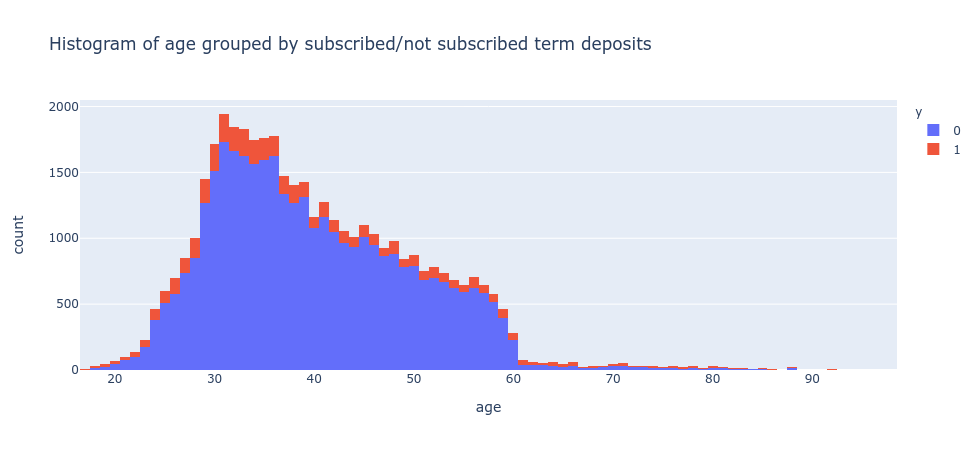

In [266]:
px.histogram(df, x="age", color="y", title="Histogram of age grouped by subscribed/not subscribed term deposits")

- Logically, the more customers are contacted by age, the more customers will not subscribe to a term deposit.

## Which jobs have mostly subscribed to a term deposit?

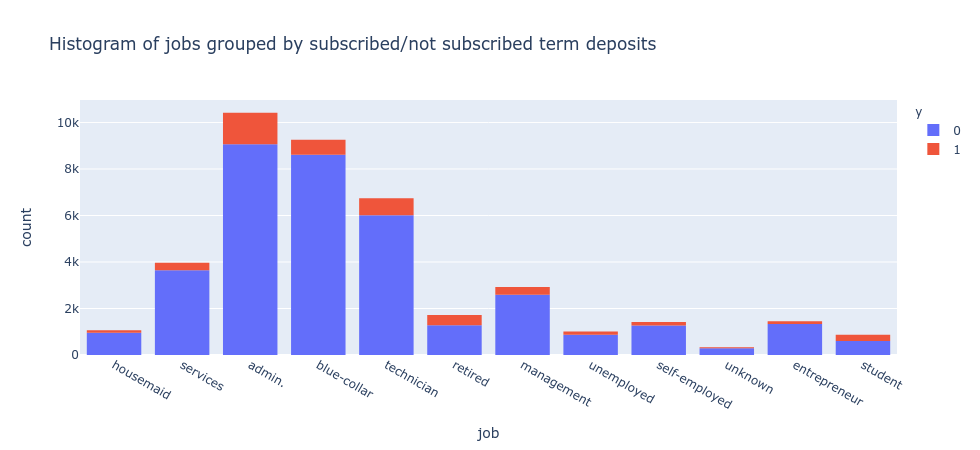

In [267]:
px.histogram(df, x="job", color="y", title="Histogram of jobs grouped by subscribed/not subscribed term deposits")

In decending order, the following jobs mostly subscribed to a term deposit:
1. admin.
2. blue-collar
3. technician
4. service
5. management

## Show the subscription rate grouped by education!

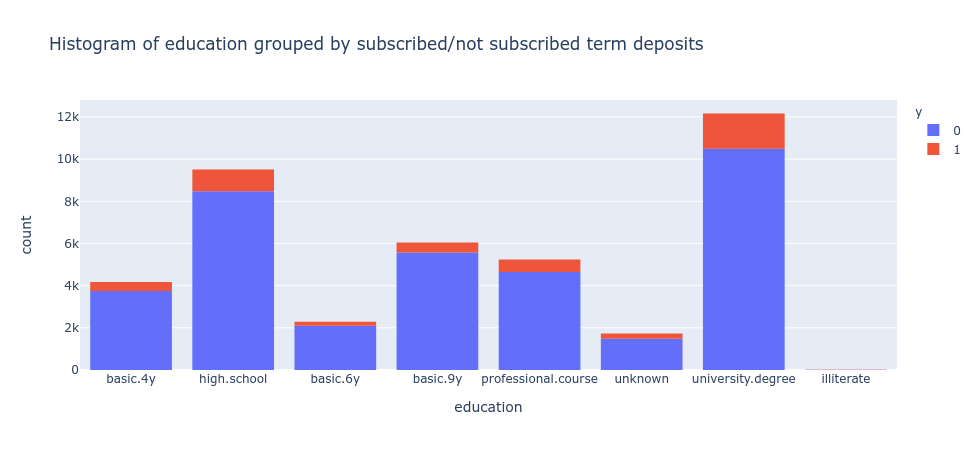

In [268]:
px.histogram(df, x="education", color="y", title="Histogram of education grouped by subscribed/not subscribed term deposits")

In decreasing order, most customers have the following educational background:
1. university degree
2. high school
3. basic 9 years
4. professional course

- Hardly any customers are illiterates.
- The second smallest group are customers where their educational background is unknown.

## For which educational levels of the customers was the last campaign most successful?

In [501]:
group_edu_y = df.groupby(["education", "y"]).size()
group_edu_y_reset = group_edu_y.reset_index()
curr_columns = group_edu_y_reset.columns.values
curr_columns[2] = "count"
group_edu_y_reset.columns = curr_columns
#group_edu_y_reset = pd.DataFrame(group_edu_y_reset) # info: not needed
group_edu_y_reset.y = group_edu_y_reset.y.map({0:'no', 1:'yes'})
group_edu_y_reset

,education,y,count
0,basic.4y,no,3748
1,basic.4y,yes,428
2,basic.6y,no,2103
3,basic.6y,yes,188
4,basic.9y,no,5572
5,basic.9y,yes,473
6,high.school,no,8481
7,high.school,yes,1031
8,illiterate,no,14
9,illiterate,yes,4


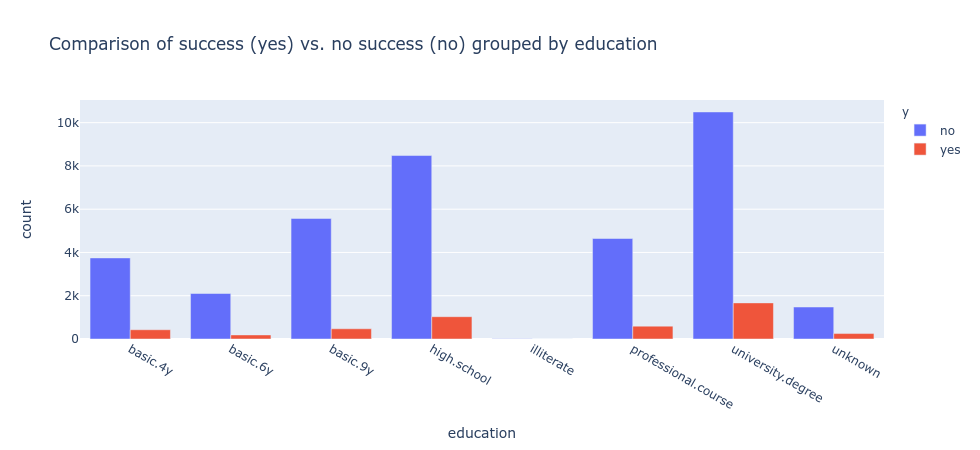

In [500]:
px.bar(group_edu_y_reset, x="education", y="count", color="y", barmode='group', title="Comparison of success (yes) vs. no success (no) grouped by education")

In [502]:
group_edu_y

education            y
basic.4y             0     3748
                     1      428
basic.6y             0     2103
                     1      188
basic.9y             0     5572
                     1      473
high.school          0     8481
                     1     1031
illiterate           0       14
                     1        4
professional.course  0     4645
                     1      595
university.degree    0    10495
                     1     1669
unknown              0     1479
                     1      251
dtype: int64

In [529]:
# calculate success rate
counter = 1
for edu in group_edu_y.index:
    if counter % 2 == 0:
        success_rate = (group_edu_y[edu[0]][1] / (group_edu_y[edu[0]][0] + group_edu_y[edu[0]][1])) * 100
        print (edu[0] + ":", success_rate.astype(float).round(1), "%")
    counter += 1

basic.4y: 10.2 %
basic.6y: 8.2 %
basic.9y: 7.8 %
high.school: 10.8 %
illiterate: 22.2 %
professional.course: 11.4 %
university.degree: 13.7 %
unknown: 14.5 %


- The highest success rate was achieved with illiterates (22.2%) and with people having an unknown education.
- Since illiterates are a very small target group and people with an unknown educational background are not an easy target group, they will be skipped, thus:
- The success rate of the most promising target grous are (in decending order):
1. Persons having a university degree (13.7%)
2. Persons having made professional courses (11.4%)
3. Persons having a high school degree (10.8%)

## For which job categories was the last campaign most successful?

In [524]:
group_job_y = df.groupby(["job", "y"]).size()
group_job_y_reset = group_job_y.reset_index()
curr_columns = group_job_y_reset.columns.values
curr_columns[2] = "count"
group_job_y_reset.columns = curr_columns
#group_job_y_reset = pd.DataFrame(group_job_y_reset) # info: not needed
group_job_y_reset.y = group_job_y_reset.y.map({0:'no', 1:'yes'})
group_job_y_reset

,job,y,count
0,admin.,no,9068
1,admin.,yes,1351
2,blue-collar,no,8615
3,blue-collar,yes,638
4,entrepreneur,no,1332
5,entrepreneur,yes,124
6,housemaid,no,954
7,housemaid,yes,106
8,management,no,2596
9,management,yes,328


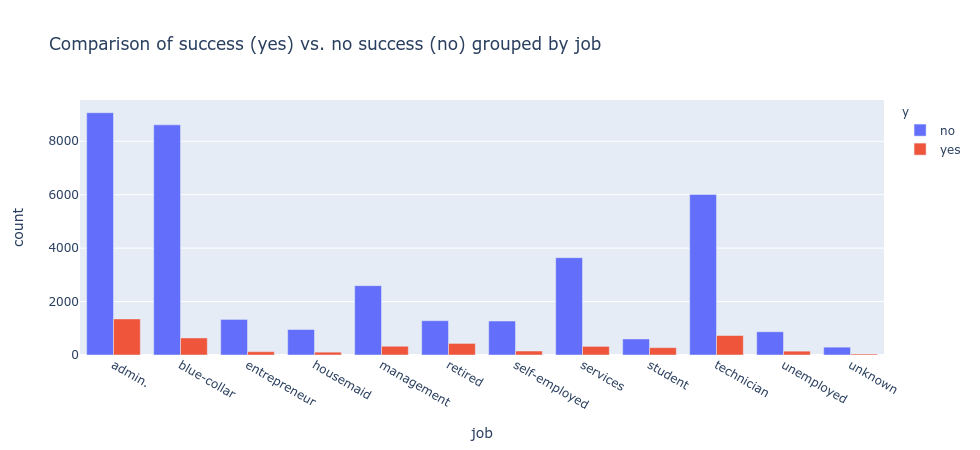

In [525]:
px.bar(group_job_y_reset, x="job", y="count", color="y", barmode='group', title="Comparison of success (yes) vs. no success (no) grouped by job")

In [526]:
group_job_y

job            y
admin.         0    9068
               1    1351
blue-collar    0    8615
               1     638
entrepreneur   0    1332
               1     124
housemaid      0     954
               1     106
management     0    2596
               1     328
retired        0    1284
               1     434
self-employed  0    1272
               1     149
services       0    3644
               1     323
student        0     600
               1     275
technician     0    6009
               1     730
unemployed     0     870
               1     144
unknown        0     293
               1      37
dtype: int64

In [530]:
# calculate success rate
counter = 1
for job in group_job_y.index:
    if counter % 2 == 0:
        success_rate = (group_job_y[job[0]][1] / (group_job_y[job[0]][0] + group_job_y[job[0]][1])) * 100
        print (job[0] + ":", success_rate.astype(float).round(1), "%")
    counter += 1

admin.: 13.0 %
blue-collar: 6.9 %
entrepreneur: 8.5 %
housemaid: 10.0 %
management: 11.2 %
retired: 25.3 %
self-employed: 10.5 %
services: 8.1 %
student: 31.4 %
technician: 10.8 %
unemployed: 14.2 %
unknown: 11.2 %


The highest success rates were achieved with the following jobs (decending):
1. students (31.4%)
2. retired people (25.3%)
3. unemployed (14.2%)
4. admin. personnel (13.0%)

## Which impact has the marital status with a term deposit?

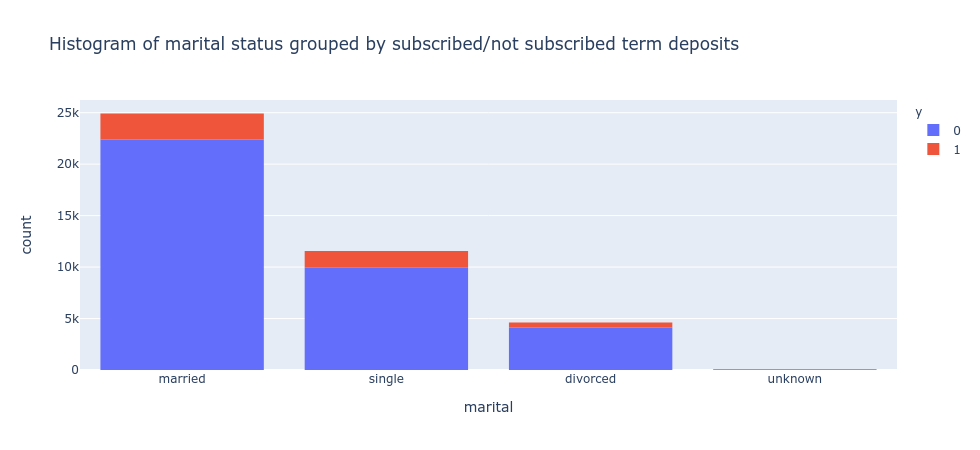

In [536]:
px.histogram(df, x="marital", color="y", title="Histogram of marital status grouped by subscribed/not subscribed term deposits")

- Most customers are married.
- Neglecting the customers, where the marital status is not known, the most seldom martial status is divorced.

## Which impact has the housing loan status with a term deposit?

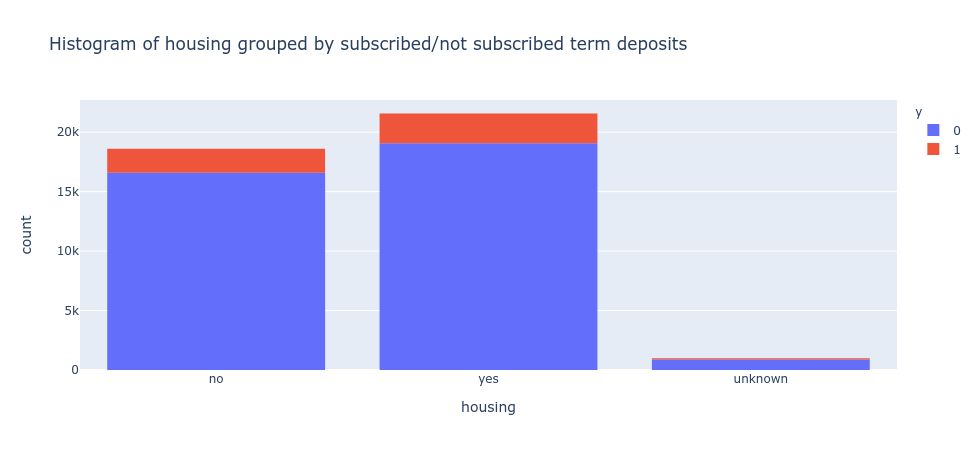

In [539]:
px.histogram(df, x="housing", color="y", title="Histogram of housing grouped by subscribed/not subscribed term deposits")

- Most customers have a housing loan.

# What is the loan status of the customers?

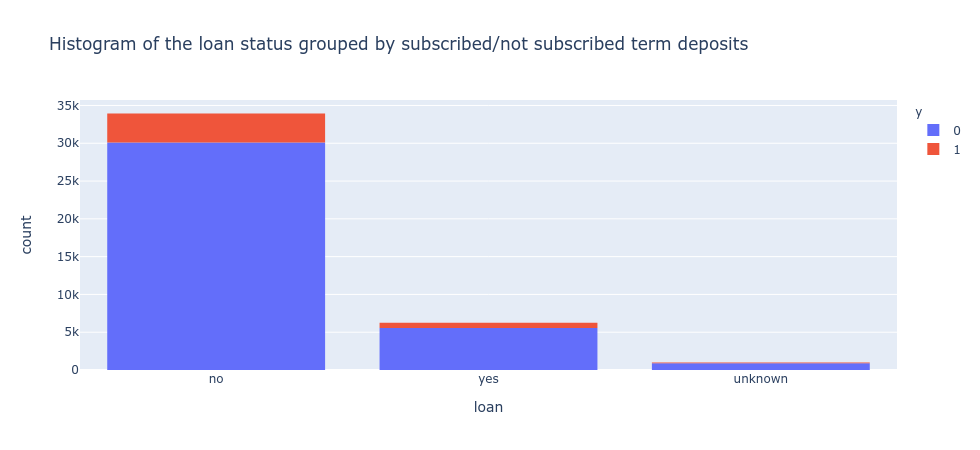

In [543]:
px.histogram(df, x="loan", color="y", title="Histogram of the loan status grouped by subscribed/not subscribed term deposits")

- Most customers have on personal loan.

## What is the default status of the customers?

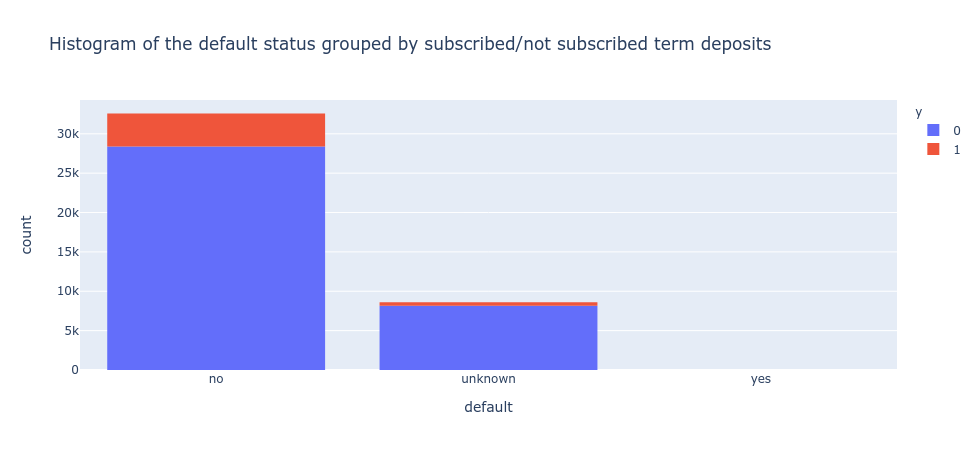

In [542]:
px.histogram(df, x="default", color="y", title="Histogram of the default status grouped by subscribed/not subscribed term deposits")

- Most customers have no credit in default.

## How have most customers been contacted?

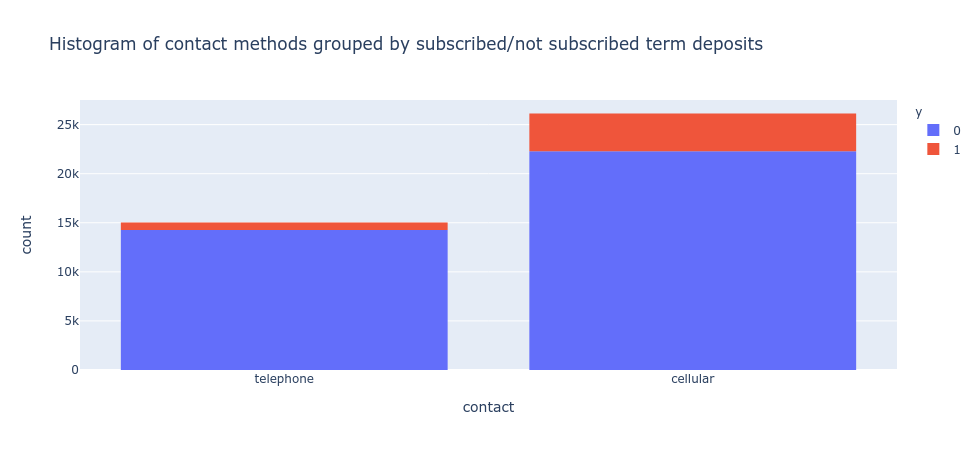

In [538]:
px.histogram(df, x="contact", color="y", title="Histogram of contact methods grouped by subscribed/not subscribed term deposits")

- Most customers have been contacted via a cellular phone.

## In which months did many customers subscribe to term deposit?

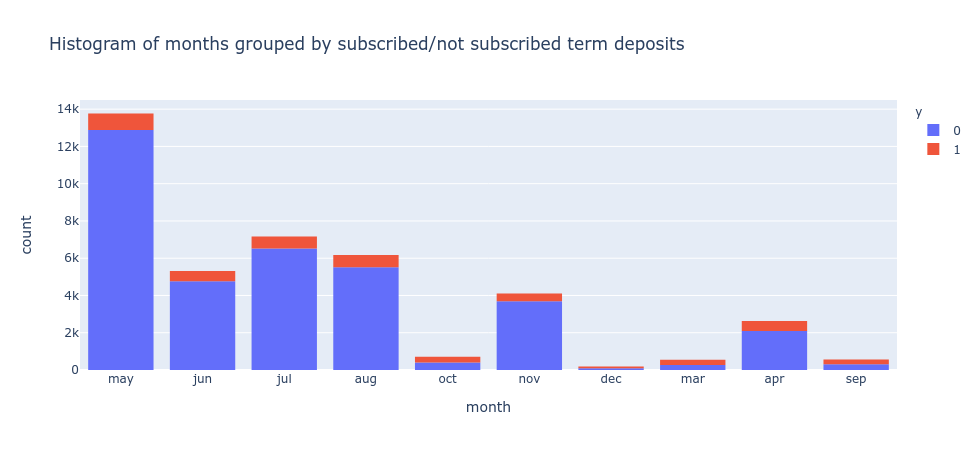

In [535]:
px.histogram(df, x="month", color="y", title="Histogram of months grouped by subscribed/not subscribed term deposits")

In decending order, many customers subscribed to a term deposit in the following months:
1. May
2. July
3. August
4. June
5. November
6. April

## Is there a significant difference in the weekday concerning the subscripton to a term deposit?

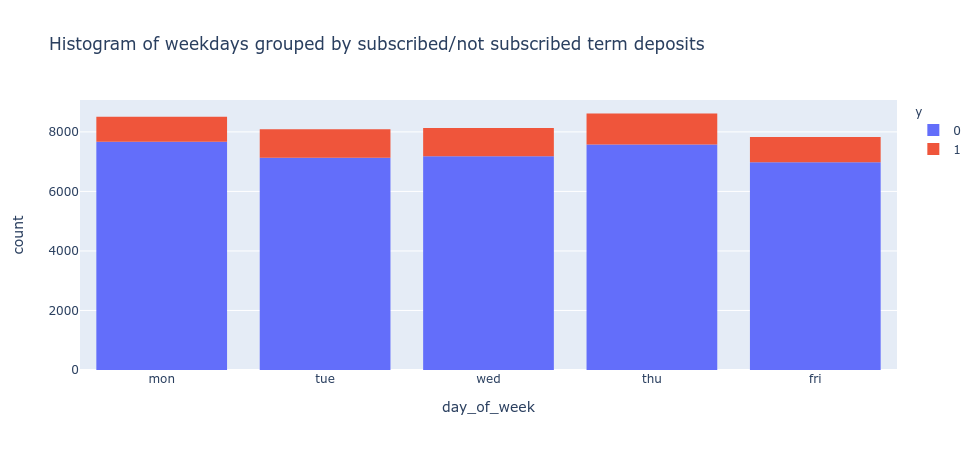

In [270]:
px.histogram(df, x="day_of_week", color="y", title="Histogram of weekdays grouped by subscribed/not subscribed term deposits")

- No, there is no significant difference in the weekday concerning the subscripton to a term deposit.

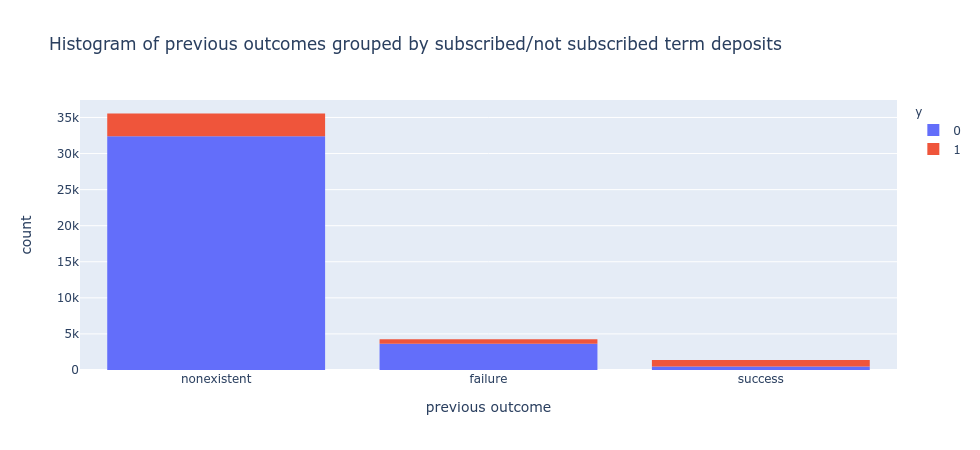

In [301]:
px.histogram(df, x="poutcome", color="y", title="Histogram of previous outcomes grouped by subscribed/not subscribed term deposits", labels={"poutcome": "previous outcome"})

In [307]:
poutcome_groups = df.poutcome.value_counts()
poutcome_groups

nonexistent    35551
failure         4252
success         1373
Name: poutcome, dtype: int64

In [308]:
amount = df.poutcome.value_counts().sum()

In [314]:
print ("nonexistent: ", (poutcome_groups['nonexistent'] / amount * 100).astype(float).round(1), "%")
print ("failure: ", (poutcome_groups['failure'] / amount * 100).astype(float).round(1), "%")
print ("success: ", (poutcome_groups['success'] / amount * 100).astype(float).round(1), "%")

nonexistent:  86.3 %
failure:  10.3 %
success:  3.3 %


- Most customers (86.3%) have not subscribed to a deposit previously.
- For 10.3% of the customers a failure occured.
- Only 3.3% of the customers actually subscribe to a term deposit.

## Did some of the customers already subscribe to a term deposit before? Give some operating numbers!

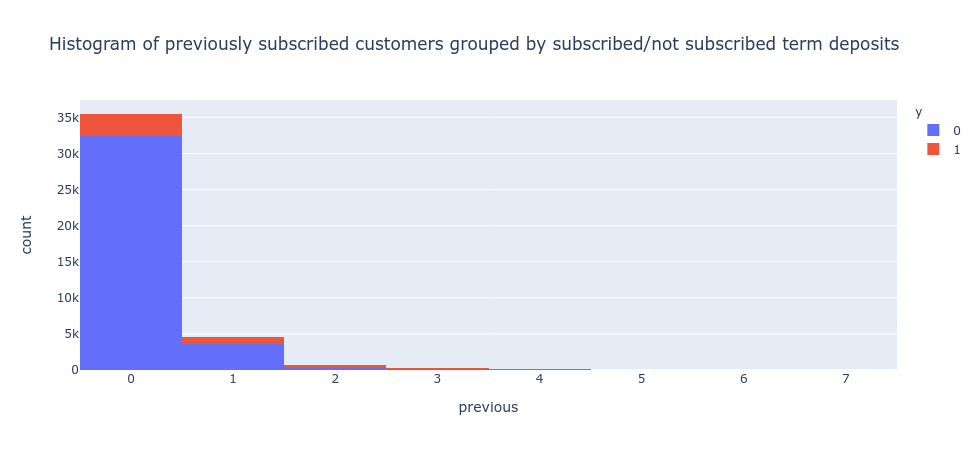

In [272]:
px.histogram(df, x="previous", color="y", title="Histogram of previously subscribed customers grouped by subscribed/not subscribed term deposits")

- Most of the customers did not subscribe to a term deposit before, as they are new customers.

### Customers who subscribed in the latest campaign

In [273]:
df[df.y == 1].previous.describe()

count    4639.000000
mean        0.492779
std         0.860406
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         6.000000
Name: previous, dtype: float64

In [274]:
subscribed_customers_previous = df[df.y == 1].previous.value_counts()
subscribed_customers_previous

0    3140
1     967
2     350
3     128
4      38
5      13
6       3
Name: previous, dtype: int64

- Most customers, who subscribed to a term deposit this time, had no deposit previously.
- Six subscribers, who have subscribed six times before, now subscribed for another term deposit in the latest campaign.

In [520]:
times_subscribed_prev = 0
for prev in subscribed_customers_previous:
    percentage = (prev / subscribed_customers_previous.sum())*100
    print (percentage.astype(float).round(1), "% of the subscribers in the latest campaign had", times_subscribed_prev, "deposit(s) before.")
    times_subscribed_prev += 1

67.7 % of the subscribers in the latest campaign had 0 deposit(s) before.
20.8 % of the subscribers in the latest campaign had 1 deposit(s) before.
7.5 % of the subscribers in the latest campaign had 2 deposit(s) before.
2.8 % of the subscribers in the latest campaign had 3 deposit(s) before.
0.8 % of the subscribers in the latest campaign had 4 deposit(s) before.
0.3 % of the subscribers in the latest campaign had 5 deposit(s) before.
0.1 % of the subscribers in the latest campaign had 6 deposit(s) before.


### Customers who did not subscribe in the latest campaign

In [276]:
df[df.y == 0].previous.describe()

count    36537.000000
mean         0.132414
std          0.409254
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          7.000000
Name: previous, dtype: float64

In [277]:
not_subscribed_customers_previous = df[df.y == 0].previous.value_counts()
not_subscribed_customers_previous

0    32411
1     3594
2      404
3       88
4       32
5        5
6        2
7        1
Name: previous, dtype: int64

- Most customers, who did not subscribe to a term deposit this time, had no deposit perviously.
- One subscriber, who has subscribed seven times before, did now not subscribe for a term deposit in the latest campaign.

In [282]:
times_subscribed_prev = 0
for prev in not_subscribed_customers_previous:
    percentage = (prev / not_subscribed_customers_previous.sum())*100
    print (percentage.astype(float).round(1), "% of the non-subscribers in the latest campaign had", times_subscribed_prev, "deposit(s) before")
    times_subscribed_prev += 1

88.7 % of the non-subscribers in the latest campaign had 0 deposit(s) before
9.8 % of the non-subscribers in the latest campaign had 1 deposit(s) before
1.1 % of the non-subscribers in the latest campaign had 2 deposit(s) before
0.2 % of the non-subscribers in the latest campaign had 3 deposit(s) before
0.1 % of the non-subscribers in the latest campaign had 4 deposit(s) before
0.0 % of the non-subscribers in the latest campaign had 5 deposit(s) before
0.0 % of the non-subscribers in the latest campaign had 6 deposit(s) before
0.0 % of the non-subscribers in the latest campaign had 7 deposit(s) before


## Show the relation between euribor3m and the age of the customers

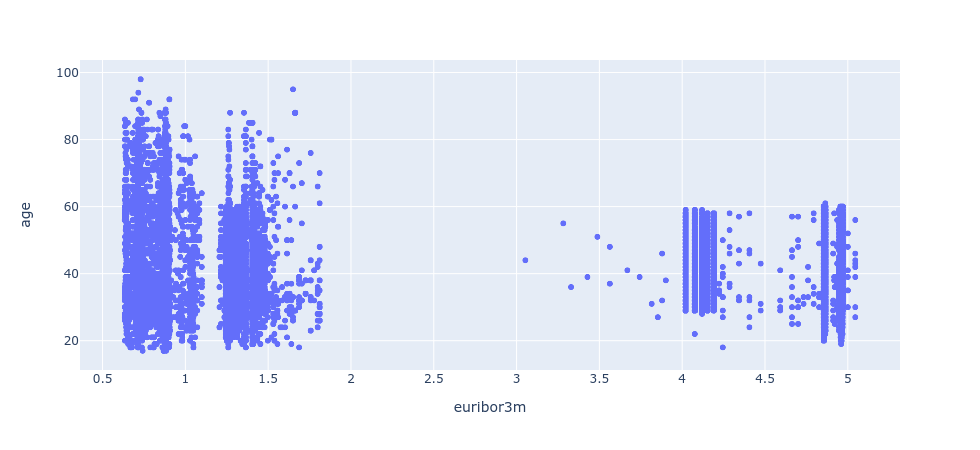

In [532]:
px.scatter(df, x="euribor3m", y="age")

- The euribor3m varies over time. The vertical "lines" show when specific campaings were made. It also shows the amount of people which were contacted at a specific campaign.

In [279]:
#import plotly.graph_objects as go
#fig = go.Figure(data=go.Bar(y=[2, 3, 1]))
#fig.show()